In [29]:
# import libraries
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from community import community_louvain
import numpy as np
from matplotlib.lines import Line2D
import matplotlib.patches as patches
from matplotlib.path import Path
from networkx.algorithms.community import girvan_newman, label_propagation_communities


In [30]:
filepath = "../datasets/chainsawman-characters.csv"

csm_df = pd.read_csv(filepath)

# Remove leading and trailing spaces from all elements in the dataframe
csm_df = csm_df.applymap(lambda x: x.strip() if isinstance(x, str) else x)

csm_df.columns = ["Character", "FriendsAllies", "Enemies", "LoveInterest", "OccupationAffliliation"]

csm_df.head()

,Character,FriendsAllies,Enemies,LoveInterest,OccupationAffliliation
0,Denji,Aki; Power; Kishibe; Kobeni; Pochita; Hirofumi...,Reze; Gun Devil; Bat Devil; Typhoon Devil; Ete...,Makima; Reze; Asa,Public Safety Devil Hunter
1,Power,Denji; Aki; Meowy; Kobeni; Kishibe,Makima; Bat Devil; Katana Man; Darkness Devil;...,NaN,Public Safety Devil Hunter
2,Aki,Denji; Power; Kishibe; Himeno; Angel; Fox Devi...,Gun Devil; Leech Devil; Katana Man; Akane; Sna...,NaN,Public Safety Devil Hunter
3,Makima,Angel; Snake Devil; Punishment Devil; Princi; ...,Denji; Power; Gun Devil; Santa Claus; Presiden...,NaN,Devil/Fiend
4,Kishibe,Denji; Aki; Kobeni; Quanxi,Makima; Santa Claus,NaN,Public Safety Devil Hunter


In [31]:
# Initialize the graph
G = nx.Graph()

In [32]:
# Add nodes and edges
for index, row in csm_df.iterrows():
    character = row['Character']
    G.add_node(character)

    # Define a function to add or update edge weights
    def add_or_update_edge_weight(u, v, relationship):
        if G.has_edge(u, v):
            G[u][v]['weight'] += 1
        else:
            G.add_edge(u, v, relationship=relationship, weight=1)

    # Add friends
    if isinstance(row['FriendsAllies'], str):
        friends = row['FriendsAllies'].split('; ')
        for friend in friends:
            if friend:
                add_or_update_edge_weight(character, friend, 'Friend/Alliance')

    # Add enemies
    if isinstance(row['Enemies'], str):
        enemies = row['Enemies'].split('; ')
        for enemy in enemies:
            if enemy:
                add_or_update_edge_weight(character, enemy, 'Enemy')

    # Add love interest
    if isinstance(row['LoveInterest'], str):
        love_interest = row['LoveInterest'].split('; ')
        for love in love_interest:
            if love:
                add_or_update_edge_weight(character, love, 'Love Interest')

In [33]:
# Get the edge weights
edge_weights = nx.get_edge_attributes(G, 'weight')

# Calculate the betweenness centrality
betweenness_centrality = nx.betweenness_centrality(G, weight='weight')

# Create occupation affiliation dictionary
occupation_dict = {row['Character']: row['OccupationAffliliation'] for _, row in csm_df.iterrows()}

In [34]:
# # Set edge colors based on their relationship
# edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]

# color_map = {
#     'friend': 'limegreen',
#     'enemy': 'tomato',
#     'love_interest': 'orchid',
# }

# # Replace relationship names with colors in the edge_colors list
# edge_colors = [color_map[color] for color in edge_colors]

# # Create occupation affiliation dictionary
# occupation_dict = {row['Character']: row['OccupationAffliliation'] for _, row in csm_df.iterrows()}

# # Define colors for occupation affiliations
# occupation_colors = {
#     'Public Safety Devil Hunter': 'limegreen',
#     'Fiend': 'tomato',
#     'Four Horsemen': 'dodgerblue',
#     "Devil": "red",
#     "Student": "white",
#     "Private Devil Hunter": "yellow"
#     # Add more colors for other occupation affiliations if needed
# }


# # Create a list of node colors based on occupation affiliation
# node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

# # Create the figure
# fig, ax = plt.subplots(figsize=(100, 100))

# # Set the plot title
# plt.title("Chainsaw Man Relationships", fontsize=192, fontweight='bold', color='white')

# # Generate the position of the nodes using the spring layout algorithm
# pos = nx.kamada_kawai_layout(G)

# # Set equal node sizes
# node_size = 75000

# # Draw the network
# node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=0.8)
# nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, arrows=True)

# # Draw node labels with some offset to avoid overlapping
# for node, (x, y) in pos.items():
#     plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.3), horizontalalignment='center', fontsize=75, color='white')

# # Create a custom legend for edge relationships
# legend_elements = [Line2D([0], [0], color=color_map[rel], lw=8, label=rel) for rel in color_map.keys()]
# plt.legend(handles=legend_elements, loc='upper right', title='Relationships', fontsize='xx-large', title_fontsize=100, prop={'size': 100})

# notes2 = ("@datawithalvin")
# plt.text(0, 0, notes2, fontsize=100, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

# # Set the face color and remove the border
# ax.set_facecolor('#0d1117')
# ax.axis('off')
# fig.set_facecolor('#0d1117')

# # Display the plot
# plt.show()

In [35]:
# # Set edge colors based on their relationship
# edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]

# color_map = {
#     'friend': 'limegreen',
#     'enemy': 'tomato',
#     'love_interest': 'orchid',
# }

# # Replace relationship names with colors in the edge_colors list
# edge_colors = [color_map[color] for color in edge_colors]

# # Create occupation affiliation dictionary
# occupation_dict = {row['Character']: row['OccupationAffliliation'] for _, row in csm_df.iterrows()}

# # Define colors for occupation affiliations
# occupation_colors = {
#     'Public Safety Devil Hunter': 'limegreen',
#     'Fiend': 'tomato',
#     'Four Horsemen': 'dodgerblue',
#     "Devil": "red",
#     "Student": "white",
#     "Private Devil Hunter": "yellow"
#     # Add more colors for other occupation affiliations if needed
# }

# # Create a list of node colors based on occupation affiliation
# node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

# # Create the figure
# fig, ax = plt.subplots(figsize=(100, 100))

# # Set the plot title
# plt.title("Chainsaw Man Relationships", fontsize=192, fontweight='bold', color='white')

# # Generate the position of the nodes using the spring layout algorithm
# pos = nx.kamada_kawai_layout(G)

# # Set equal node sizes
# node_size = 75000

# # Draw the network
# node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=0.8)
# nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors)

# # Draw node labels with some offset to avoid overlapping
# for node, (x, y) in pos.items():
#     plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.3), horizontalalignment='center', fontsize=75, color='white')

# # Create custom legend elements for edge relationships
# relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=8, label=rel) for rel in color_map.keys()]

# # Create custom legend elements for occupation affiliations
# occupation_legend_elements = [Patch(facecolor=occupation_colors[occ], label=occ) for occ in occupation_colors.keys()]

# # Combine edge relationship and occupation affiliation legends
# legend_elements = relationship_legend_elements + occupation_legend_elements
# plt.legend(handles=legend_elements, loc='upper right', fontsize='xx-large', prop={'size': 100}, ncol=2)

# notes2 = ("@datawithalvin")
# plt.text(0, 0, notes2, fontsize=100, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

# # Set the face color and remove the border
# ax.set_facecolor('#0d1117')
# ax.axis('off')
# fig.set_facecolor('#0d1117')

# # Display the plot
# plt.show()

In [36]:
# partition = community_louvain.best_partition(G)


# def community_layout(g, partition):
#     pos_communities = nx.spring_layout(g, seed=42, k=1)  # Position of communities
#     pos_nodes = {}
#     for node, community in partition.items():
#         pos_nodes[node] = pos_communities[node] + np.array([0, 0])  # Position of nodes within communities

#     return pos_nodes


# pos = community_layout(G, partition)

# # Set edge colors based on their relationship
# edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]

# color_map = {
#     'friend': 'limegreen',
#     'enemy': 'tomato',
#     'love_interest': 'orchid',
# }

# # Replace relationship names with colors in the edge_colors list
# edge_colors = [color_map[color] for color in edge_colors]

# # Create occupation affiliation dictionary
# occupation_dict = {row['Character']: row['OccupationAffliliation'] for _, row in csm_df.iterrows()}

# # Define colors for occupation affiliations
# occupation_colors = {
#     'Public Safety Devil Hunter': 'limegreen',
#     'Fiend': 'tomato',
#     'Four Horsemen': 'dodgerblue',
#     "Devil": "red",
#     "Student": "white",
#     "Private Devil Hunter": "yellow",
#     "Other Side Character": "blue"
#     # Add more colors for other occupation affiliations if needed
# }

# # Create a list of node colors based on occupation affiliation
# node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

# # Create the figure
# fig, ax = plt.subplots(figsize=(100, 100))

# # Set the plot title
# plt.title("Chainsaw Man Relationships", fontsize=192, fontweight='bold', color='white')

# # Generate the position of the nodes using the spring layout algorithm
# # pos = nx.kamada_kawai_layout(G)

# # Set equal node sizes
# node_size = 75000

# # Draw the network
# node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=0.8)
# nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors)

# # Draw node labels with some offset to avoid overlapping
# for node, (x, y) in pos.items():
#     plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.3), horizontalalignment='center', fontsize=75, color='white')

# # Create custom legend elements for edge relationships
# relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=8, label=rel) for rel in color_map.keys()]

# # Create custom legend elements for occupation affiliations
# occupation_legend_elements = [Patch(facecolor=occupation_colors[occ], label=occ) for occ in occupation_colors.keys()]

# # Combine edge relationship and occupation affiliation legends
# legend_elements = relationship_legend_elements + occupation_legend_elements
# plt.legend(handles=legend_elements, loc='upper right', fontsize='xx-large', prop={'size': 100}, ncol=2)

# notes2 = ("@datawithalvin")
# plt.text(0, 0, notes2, fontsize=100, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

# # Set the face color and remove the border
# ax.set_facecolor('#0d1117')
# ax.axis('off')
# fig.set_facecolor('#0d1117')

# # Display the plot
# plt.show()

In [37]:
# # Girvan-Newman method
# communities = girvan_newman(G)
# partition_girvan_newman = {node: i for i, com in enumerate(next(communities)) for node in com}
# # Uncomment the line below to use Girvan-Newman instead of Louvain method
# partition = partition_girvan_newman

# pos = community_layout(G, partition)

# # Set edge colors based on their relationship
# edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]

# color_map = {
#     'friend': 'limegreen',
#     'enemy': 'tomato',
#     'love_interest': 'orchid',
# }

# # Replace relationship names with colors in the edge_colors list
# edge_colors = [color_map[color] for color in edge_colors]

# # Create occupation affiliation dictionary
# occupation_dict = {row['Character']: row['OccupationAffliliation'] for _, row in csm_df.iterrows()}

# occupation_colors = {
#     'Public Safety Devil Hunter': 'mediumpurple',
#     'Devil/Fiend': 'salmon',
#     "Private Devil Hunter": "blue",
#     "Side Character": "cyan"
# }

# # Create a list of node colors based on occupation affiliation
# node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

# # Create the figure
# fig, ax = plt.subplots(figsize=(100, 100))

# # Set the plot title
# plt.title("Chainsaw Man Relationships", fontsize=192, fontweight='bold', color='white')

# # Generate the position of the nodes using the spring layout algorithm
# # pos = nx.kamada_kawai_layout(G)

# # Set equal node sizes
# node_size = 75000

# # Draw the network
# node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=0.8)
# nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors)

# # Draw node labels with some offset to avoid overlapping
# for node, (x, y) in pos.items():
#     plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.3), horizontalalignment='center', fontsize=75, color='white')

# # Create custom legend elements for edge relationships
# relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=8, label=rel) for rel in color_map.keys()]

# # Create custom legend elements for occupation affiliations (with circle symbols)
# occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
#                                     markerfacecolor=occupation_colors[occ], markersize=25) for occ in occupation_colors.keys()]

# # Combine edge relationship and occupation affiliation legends
# legend_elements = relationship_legend_elements + occupation_legend_elements
# # Adjust legend size and symbol
# plt.legend(handles=legend_elements, loc='upper right', fontsize='x-large', prop={'size': 50}, ncol=2)

# notes2 = ("@datawithalvin")
# plt.text(0, 0, notes2, fontsize=50, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

# # Set the face color and remove the border
# ax.set_facecolor('#0d1117')
# ax.axis('off')
# fig.set_facecolor('#0d1117')

# # Display the plot
# plt.show()

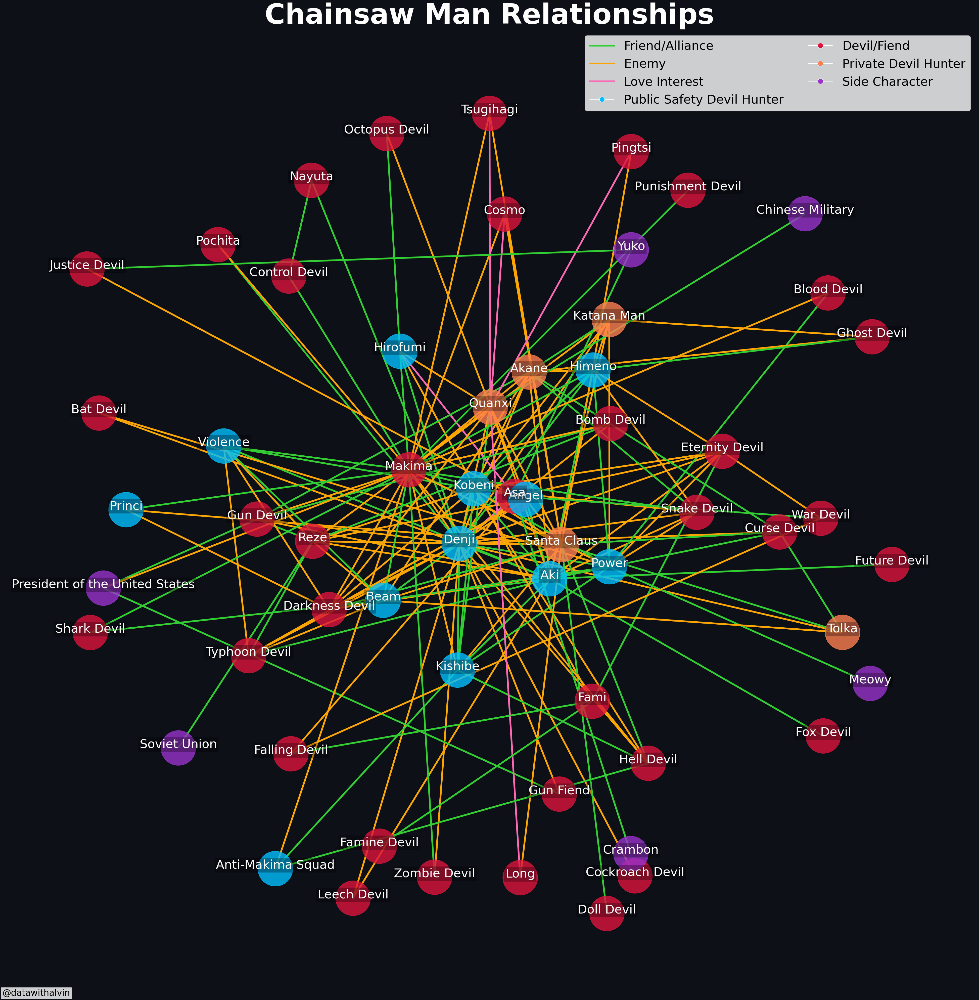

In [38]:
# Girvan-Newman method
communities = girvan_newman(G)
partition_girvan_newman = {node: i for i, com in enumerate(next(communities)) for node in com}
# Uncomment the line below to use Girvan-Newman instead of Louvain method
partition = partition_girvan_newman

def community_layout(g, partition):
    pos_communities = nx.spring_layout(g, seed=666, k=1.25)  # Position of communities

    # Find the center of each community
    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_communities[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    # Position nodes within their communities
    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_communities[node] - community_centers[community]

    return pos_nodes

pos = community_layout(G, partition)

# Set edge colors based on their relationship
edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]

# Set edge colors based on their relationship
edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]

# Set edge colors based on their relationship (pastel shades)
color_map = {
    'Friend/Alliance': 'limegreen',
    'Enemy': '#FFA500',
    'Love Interest': '#FF69B4',
}


# Replace relationship names with colors in the edge_colors list
edge_colors = [color_map[color] for color in edge_colors]

# Create occupation affiliation dictionary
occupation_dict = {row['Character']: row['OccupationAffliliation'] for _, row in csm_df.iterrows()}


occupation_colors = {
    'Public Safety Devil Hunter': '#00BFFF',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "#FF7F50",
    "Side Character": "#9932CC"
}

# Create a list of node colors based on occupation affiliation
node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

# Create the figure
fig, ax = plt.subplots(figsize=(50, 50))

# Set the plot title
plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

# Generate the position of the nodes using the spring layout algorithm
# pos = nx.kamada_kawai_layout(G)

# Set equal node sizes
node_size = 10000

# Draw the network
node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=5, edge_color=edge_colors)

# Draw node labels with some offset to avoid overlapping
for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.3), horizontalalignment='center', fontsize=35, color='white')

# Create custom legend elements for edge relationships
relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]

# Create custom legend elements for occupation affiliations (with circle symbols)
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=15) for occ in occupation_colors.keys()]

# Combine edge relationship and occupation affiliation legends
legend_elements = relationship_legend_elements + occupation_legend_elements
# Adjust legend size and symbol
plt.legend(handles=legend_elements, loc='upper right', fontsize='x-large', prop={'size': 35}, ncol=2)

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=25, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

# Set the face color and remove the border
ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

# Display the plot
plt.show()

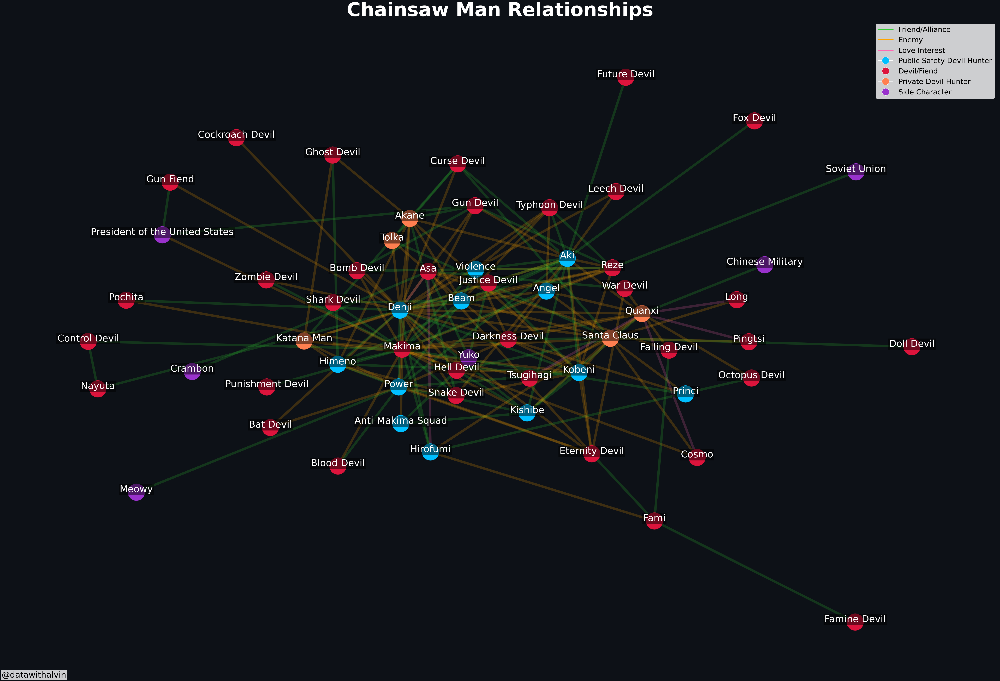

In [39]:
# Label Propagation method
communities = list(label_propagation_communities(G))
partition_label_propagation = {node: i for i, com in enumerate(communities) for node in com}
# Uncomment the line below to use Label Propagation instead of Louvain method
partition = partition_label_propagation

def community_layout(g, partition):
    pos_communities = nx.kamada_kawai_layout(g)  # Position of communities

    # Find the center of each community
    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_communities[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    # Position nodes within their communities
    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_communities[node] - community_centers[community]

    return pos_nodes

pos = community_layout(G, partition)

# Set edge colors based on their relationship
edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]

# Set edge colors based on their relationship (pastel shades)
color_map = {
    'Friend/Alliance': 'limegreen',
    'Enemy': '#FFA500',
    'Love Interest': '#FF69B4',
}


# Replace relationship names with colors in the edge_colors list
edge_colors = [color_map[color] for color in edge_colors]

# Create occupation affiliation dictionary
occupation_dict = {row['Character']: row['OccupationAffliliation'] for _, row in csm_df.iterrows()}


occupation_colors = {
    'Public Safety Devil Hunter': '#00BFFF',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "#FF7F50",
    "Side Character": "#9932CC"
}

# Create a list of node colors based on occupation affiliation
node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

# Create the figure
fig, ax = plt.subplots(figsize=(75, 50))

# Set the plot title
plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

# Generate the position of the nodes using the spring layout algorithm
# pos = nx.kamada_kawai_layout(G)

# Set equal node sizes
node_size = 5000

# Draw the network
node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=1)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, alpha=0.2)

# Draw node labels with some offset to avoid overlapping
for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.5), horizontalalignment='center', fontsize=40, color='white')

# Create custom legend elements for edge relationships
relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]

# Create custom legend elements for occupation affiliations (with circle symbols)
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='large', prop={'size': 30}, ncol=1, facecolor=(1, 1, 1, 0.1), edgecolor='none')

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=35, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

plt.show()

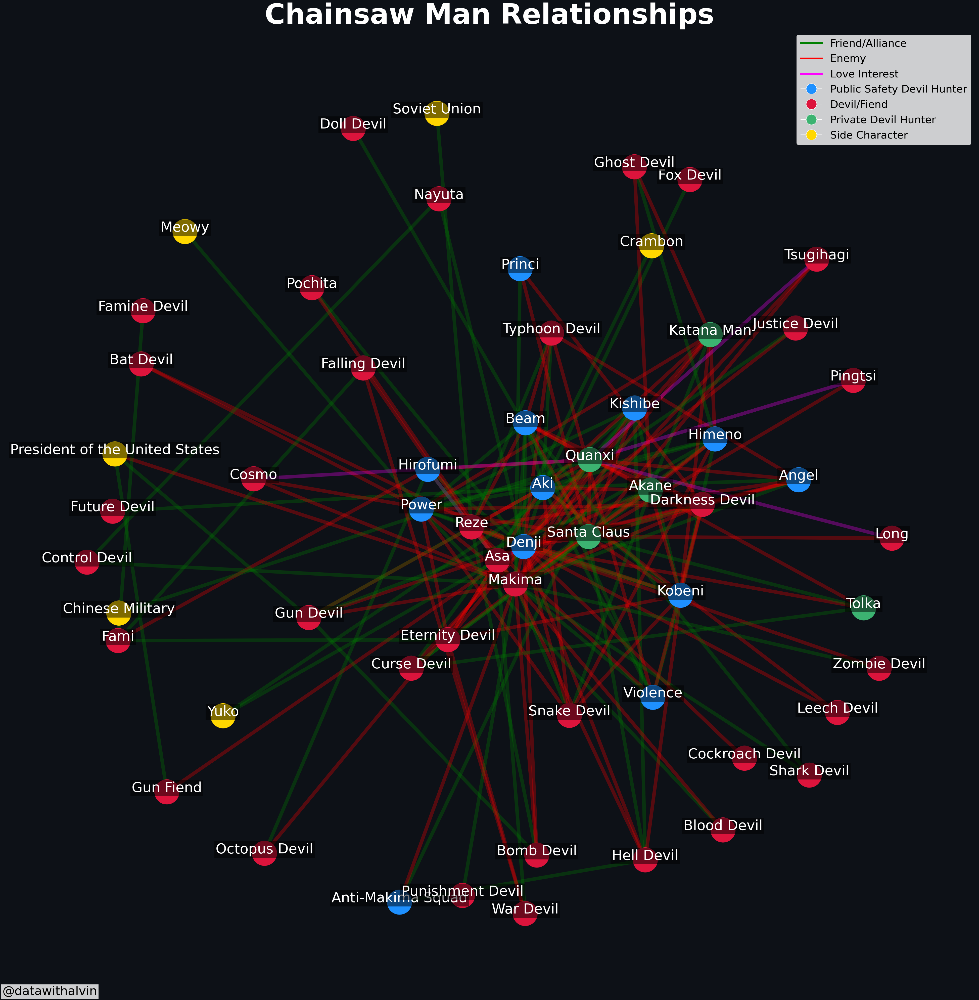

In [40]:
# Label Propagation method
communities = list(label_propagation_communities(G))
partition_label_propagation = {node: i for i, com in enumerate(communities) for node in com}
partition = partition_label_propagation

def community_layout(g, partition):
    pos_communities = nx.spring_layout(g, seed=77777, k=1.35)  # Position of communities

    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_communities[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_communities[node] - community_centers[community]

    return pos_nodes

pos = community_layout(G, partition)

# Set edge colors based on their relationship (vibrant shades)
color_map = {
    'Friend/Alliance': 'green',
    'Enemy': 'red',
    'Love Interest': 'magenta',
}

edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]
edge_colors = [color_map[color] for color in edge_colors]

occupation_colors = {
    'Public Safety Devil Hunter': 'dodgerblue',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "mediumseagreen",
    "Side Character": "gold"
}

node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

fig, ax = plt.subplots(figsize=(50, 50))

plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

node_size = 5000

node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=1)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, alpha=0.3)

for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.5), horizontalalignment='center', fontsize=40, color='white')

relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

# ...
legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='large', prop={'size': 30}, ncol=1, facecolor=(1, 1, 1, 0.5), edgecolor='none')

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=35, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

plt.show()

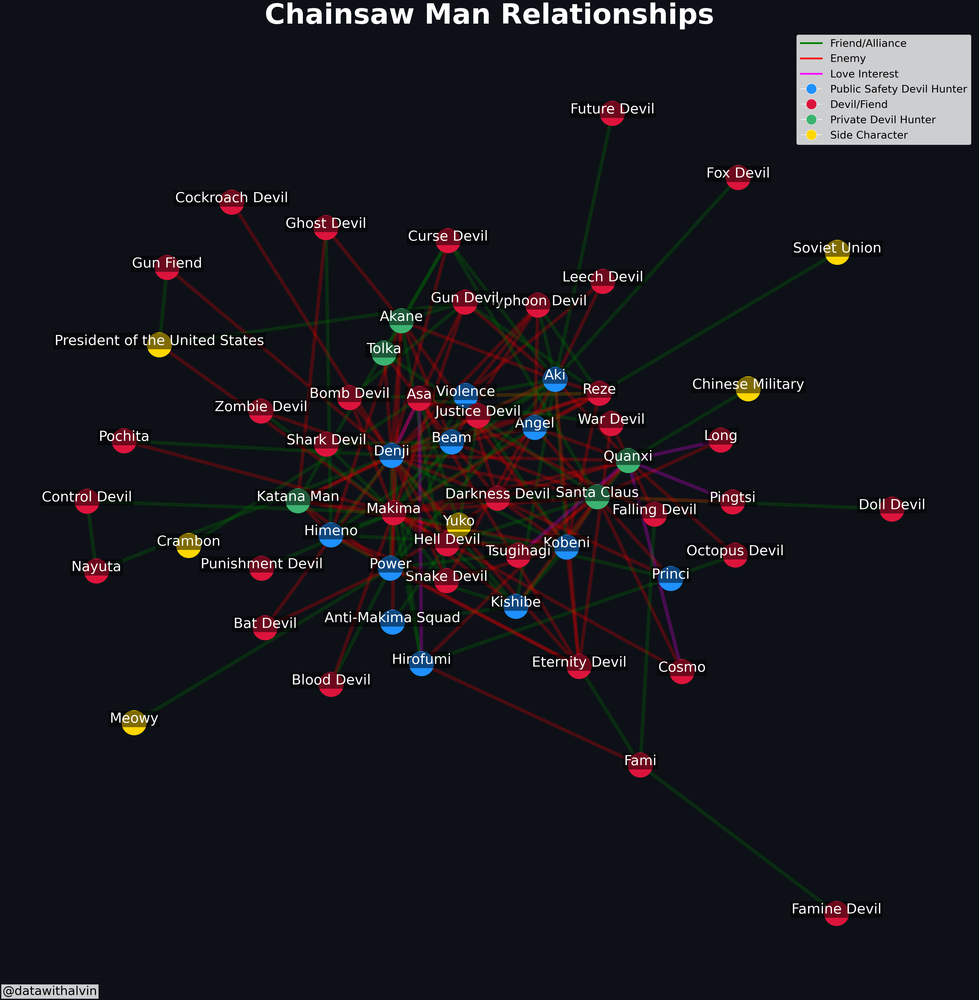

In [41]:
# Label Propagation method
communities = list(label_propagation_communities(G))
partition_label_propagation = {node: i for i, com in enumerate(communities) for node in com}
partition = partition_label_propagation

def community_layout(g, partition):
    pos_communities = nx.kamada_kawai_layout(g) # Position of communities

    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_communities[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_communities[node] - community_centers[community]

    return pos_nodes

pos = community_layout(G, partition)

# Set edge colors based on their relationship (vibrant shades)
color_map = {
    'Friend/Alliance': 'green',
    'Enemy': 'red',
    'Love Interest': 'magenta',
}

edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]
edge_colors = [color_map[color] for color in edge_colors]

occupation_colors = {
    'Public Safety Devil Hunter': 'dodgerblue',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "mediumseagreen",
    "Side Character": "gold"
}

node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

fig, ax = plt.subplots(figsize=(50, 50))

plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

node_size = 5000

node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=1)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, alpha=0.25)

for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.5), horizontalalignment='center', fontsize=40, color='white')

relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

# ...
legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='large', prop={'size': 30}, ncol=1, facecolor=(1, 1, 1, 0.5), edgecolor='none')

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=35, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

plt.show()

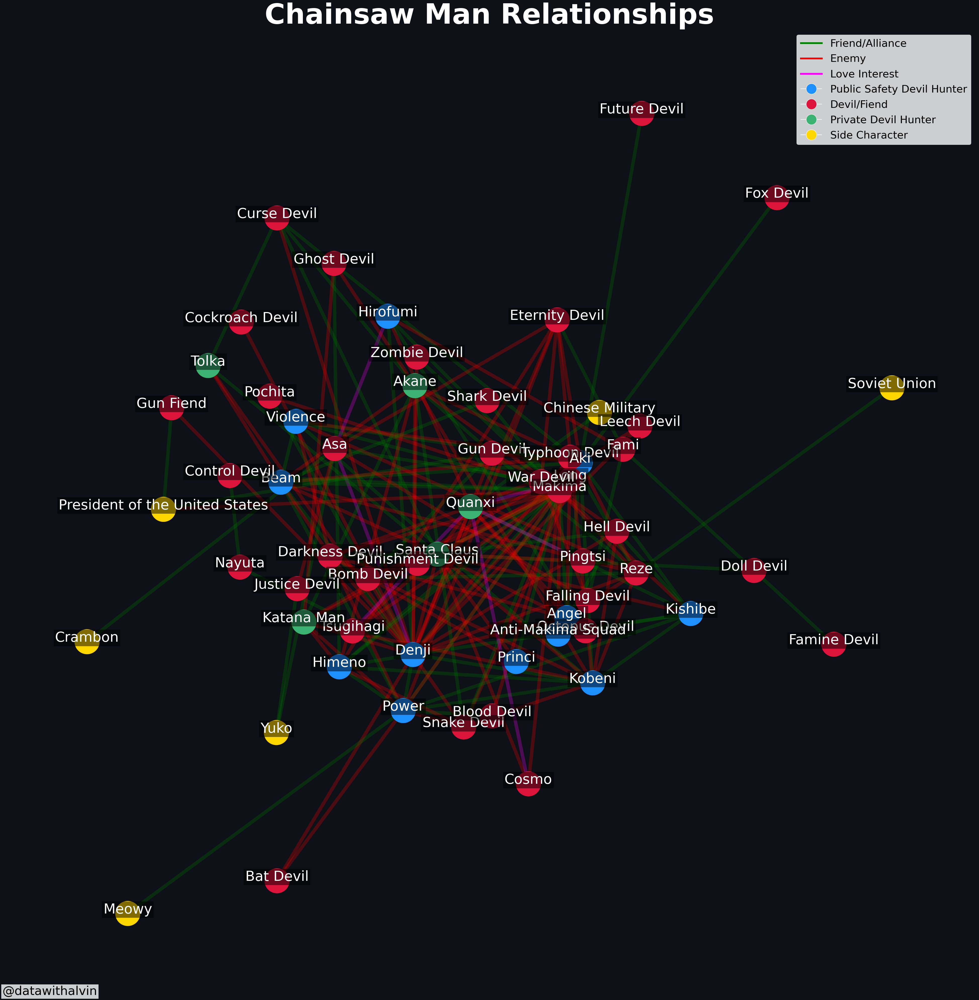

In [42]:
from networkx.algorithms import community

partition_fast_greedy = community.greedy_modularity_communities(G)
partition_fast_greedy = {node: i for i, com in enumerate(partition_fast_greedy) for node in com}


def community_layout(g, partition):
    pos_communities = nx.kamada_kawai_layout(g) # Position of communities

    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_communities[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_communities[node] - community_centers[community]

    return pos_nodes

pos = community_layout(G, partition_fast_greedy)

# Set edge colors based on their relationship (vibrant shades)
color_map = {
    'Friend/Alliance': 'green',
    'Enemy': 'red',
    'Love Interest': 'magenta',
}

edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]
edge_colors = [color_map[color] for color in edge_colors]

occupation_colors = {
    'Public Safety Devil Hunter': 'dodgerblue',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "mediumseagreen",
    "Side Character": "gold"
}

node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

fig, ax = plt.subplots(figsize=(50, 50))

plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

node_size = 5000

node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=1)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, alpha=0.25)

for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.5), horizontalalignment='center', fontsize=40, color='white')

relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

# ...
legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='large', prop={'size': 30}, ncol=1, facecolor=(1, 1, 1, 0.5), edgecolor='none')

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=35, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

plt.show()

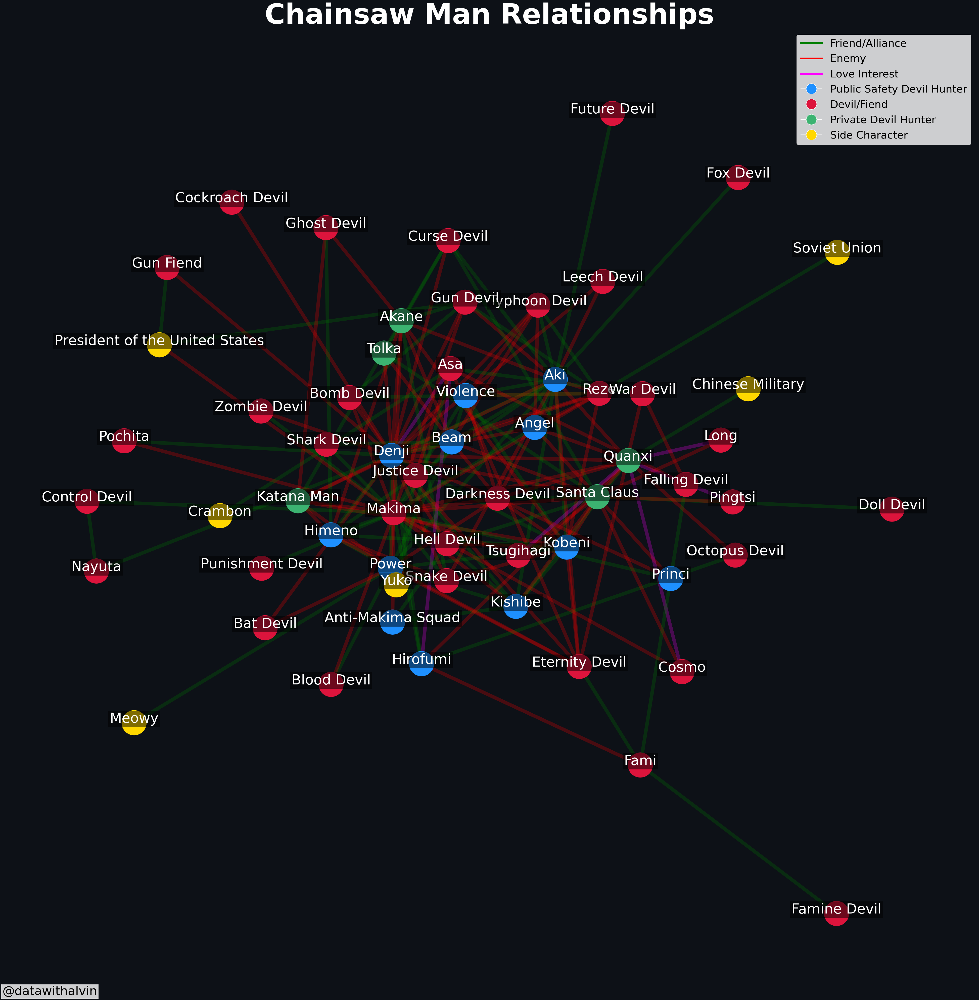

In [43]:
communities_generator = community.girvan_newman(G)
top_level_communities = next(communities_generator)
partition_girvan_newman = {node: i for i, com in enumerate(top_level_communities) for node in com}

def community_layout(g, partition):
    pos_communities = nx.kamada_kawai_layout(g) # Position of communities

    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_communities[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_communities[node] - community_centers[community]

    return pos_nodes

pos = community_layout(G, partition_girvan_newman)

# Set edge colors based on their relationship (vibrant shades)
color_map = {
    'Friend/Alliance': 'green',
    'Enemy': 'red',
    'Love Interest': 'magenta',
}

edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]
edge_colors = [color_map[color] for color in edge_colors]

occupation_colors = {
    'Public Safety Devil Hunter': 'dodgerblue',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "mediumseagreen",
    "Side Character": "gold"
}

node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

fig, ax = plt.subplots(figsize=(50, 50))

plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

node_size = 5000

node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=1)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, alpha=0.25)

for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.5), horizontalalignment='center', fontsize=40, color='white')

relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

# ...
legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='large', prop={'size': 30}, ncol=1, facecolor=(1, 1, 1, 0.5), edgecolor='none')

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=35, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

plt.show()

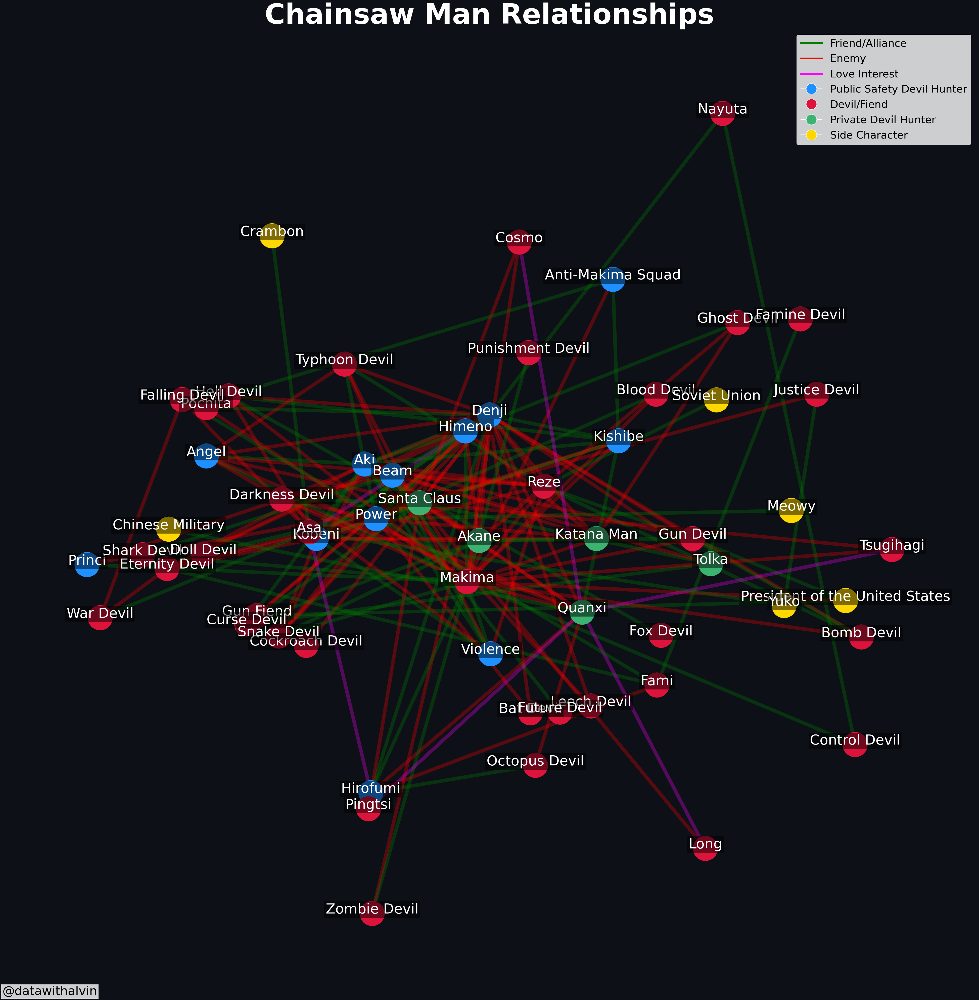

In [44]:
# Louvain Method
partition_louvain = community_louvain.best_partition(G)

def community_layout(g, partition):
    pos_communities = nx.spring_layout(g, seed=66, k=1.5)  # Position of communities

    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_communities[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_communities[node] - community_centers[community]

    return pos_nodes

pos = community_layout(G, partition_louvain)

# Set edge colors based on their relationship (vibrant shades)
color_map = {
    'Friend/Alliance': 'green',
    'Enemy': 'red',
    'Love Interest': 'magenta',
}

edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]
edge_colors = [color_map[color] for color in edge_colors]

occupation_colors = {
    'Public Safety Devil Hunter': 'dodgerblue',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "mediumseagreen",
    "Side Character": "gold"
}

node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

fig, ax = plt.subplots(figsize=(50, 50))

plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

node_size = 5000

node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=1)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, alpha=0.3)

for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.5), horizontalalignment='center', fontsize=40, color='white')

relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

# ...
legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='large', prop={'size': 30}, ncol=1, facecolor=(1, 1, 1, 0.5), edgecolor='none')

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=35, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

plt.show()

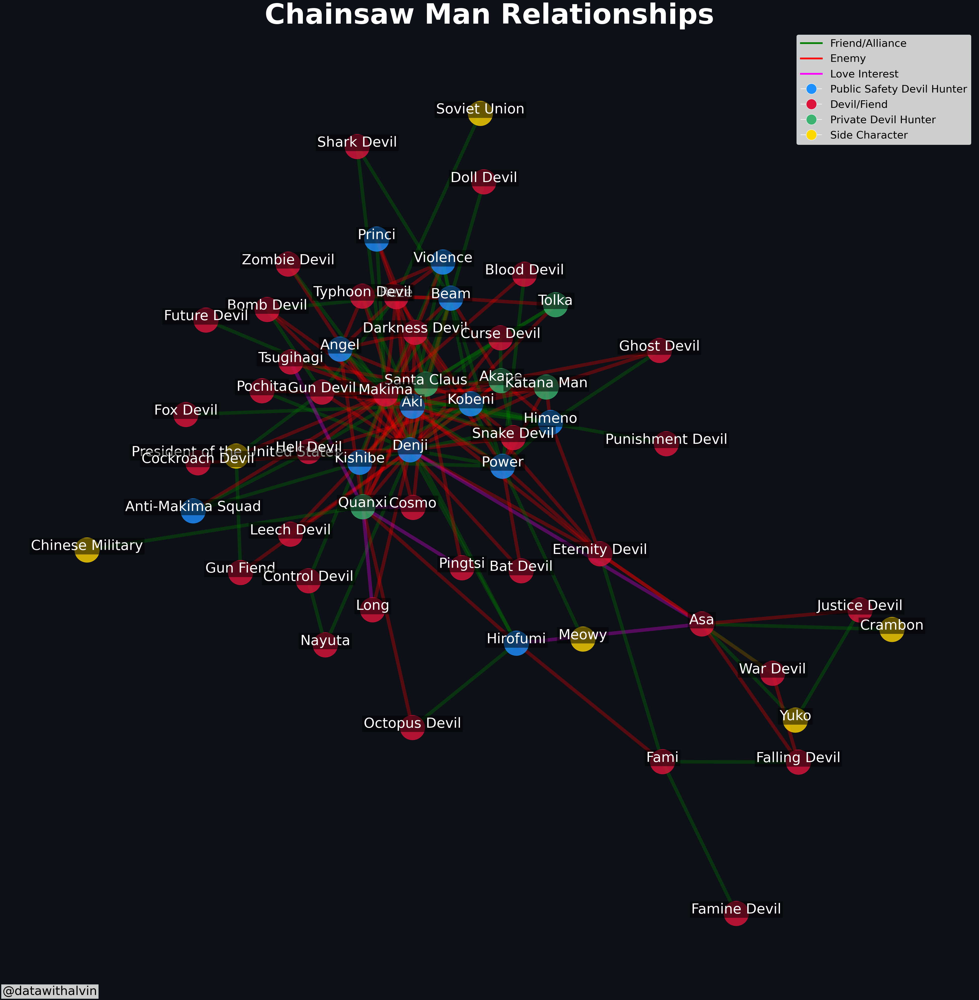

In [45]:
# Clauset-Newman-Moore Greedy Modularity Maximization Method
communities_cnmg = nx.community.greedy_modularity_communities(G)
partition_cnmg = {node: i for i, com in enumerate(communities_cnmg) for node in com}

def community_layout(g, partition, scale=1, k=0.5):
    pos_fr = nx.spring_layout(g, seed=42, scale=scale, k=0.5)  # Fruchterman-Reingold layout

    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_fr[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_fr[node] + 0.1 * (community_centers[community] - pos_fr[node])

    return pos_nodes

pos = community_layout(G, partition_cnmg, scale=2, k=1.75)


# Set edge colors based on their relationship (vibrant shades)
color_map = {
    'Friend/Alliance': 'green',
    'Enemy': 'red',
    'Love Interest': 'magenta',
}

edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]
edge_colors = [color_map[color] for color in edge_colors]

occupation_colors = {
    'Public Safety Devil Hunter': 'dodgerblue',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "mediumseagreen",
    "Side Character": "gold"
}

node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

fig, ax = plt.subplots(figsize=(50, 50))

plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

node_size = 5000

node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, alpha=0.3)

for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.5), horizontalalignment='center', fontsize=40, color='white')

relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

# ...
legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='large', prop={'size': 30}, ncol=1, facecolor=(1, 1, 1, 0.5), edgecolor='none')

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=35, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

plt.show()

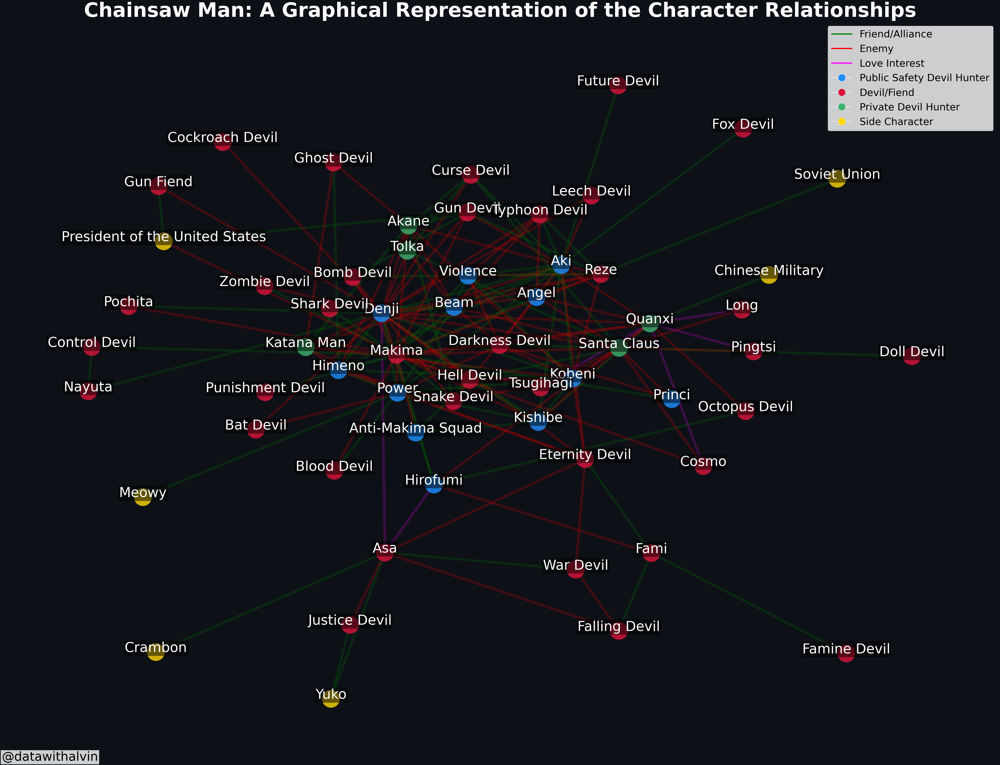

In [50]:
partition_louvain = community_louvain.best_partition(G)

def community_layout(g, partition, scale=1):
    pos_fr = nx.kamada_kawai_layout(g)  # Kamada-Kawai layout

    # Scale the positions of nodes
    for node in pos_fr:
        pos_fr[node] *= scale

    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_fr[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_fr[node] + 0.1 * (community_centers[community] - pos_fr[node])

    return pos_nodes


pos = community_layout(G, partition_louvain, scale=5)


# Set edge colors based on their relationship (vibrant shades)
color_map = {
    'Friend/Alliance': 'green',
    'Enemy': 'red',
    'Love Interest': 'magenta',
}

edge_colors = [G[u][v]['relationship'] for u, v in G.edges()]
edge_colors = [color_map[color] for color in edge_colors]

occupation_colors = {
    'Public Safety Devil Hunter': 'dodgerblue',
    'Devil/Fiend': 'crimson',
    "Private Devil Hunter": "mediumseagreen",
    "Side Character": "gold"
}

node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in G.nodes()]

fig, ax = plt.subplots(figsize=(72, 54))

plt.title("Chainsaw Man: A Graphical Representation of the Character Relationships", fontsize=80, fontweight='bold', color='white')

node_size = 5000

node_collection = nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=0.8)
nx.draw_networkx_edges(G, pos, edgelist=list(edge_weights.keys()), width=10, edge_color=edge_colors, alpha=0.2)

for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.5), horizontalalignment='center', fontsize=55, color='white')

relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

# ...
legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='large', prop={'size': 40}, ncol=1, facecolor=(1, 1, 1, 0.5), edgecolor='none')

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=50, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')
# fig.savefig('../output/chainsaw_man_relationships-2.jpg', dpi=150)

plt.show()

In [32]:
# Initialize the MultiGraph
MG = nx.MultiGraph()

# Add nodes and edges to the MultiGraph
for index, row in csm_df.iterrows():
    character = row['Character']
    MG.add_node(character)

    # Add friends
    if isinstance(row['FriendsAllies'], str):
        friends = row['FriendsAllies'].split('; ')
        for friend in friends:
            if friend:
                MG.add_edge(character, friend, relationship='Friend/Alliance')

    # Add enemies
    if isinstance(row['Enemies'], str):
        enemies = row['Enemies'].split('; ')
        for enemy in enemies:
            if enemy:
                MG.add_edge(character, enemy, relationship='Enemy')

    # Add love interest
    if isinstance(row['LoveInterest'], str):
        love_interest = row['LoveInterest'].split('; ')
        for love in love_interest:
            if love:
                MG.add_edge(character, love, relationship='Love Interest')

In [64]:
def draw_curved_edges(G, pos, edgelist=None, width=1, alpha=1, edge_color='k', arrows=True, style='solid', ax=None, **kwds):
    if ax is None:
        ax = plt.gca()
        
    if edgelist is None:
        edgelist = G.edges(keys=True)
        
    edge_relationships = nx.get_edge_attributes(G, 'relationship')
    
    for (n1, n2, key) in edgelist:
        color = color_map[edge_relationships[(n1, n2, key)]]
        c = np.array([pos[n1], pos[n2]])
        k = np.array([-c[1, 1], c[0, 1]]) - np.array([-c[0, 1], c[1, 1]])
        c1 = c[0] + k * 0.1
        c2 = c[1] - k * 0.1
        bezier_points = np.array([c[0], c1, c2, c[1]])
        codes = [Path.MOVETO, Path.CURVE4, Path.CURVE4, Path.CURVE4]
        path = Path(bezier_points, codes)
        patch = patches.PathPatch(path, lw=width, linestyle=style, color=color, alpha=alpha, **kwds)
        ax.add_patch(patch)
        
    # Draw the arrows if required
    if arrows:
        for (n1, n2, key) in edgelist:
            color = color_map[edge_relationships[(n1, n2, key)]]
            vec = pos[n2] - pos[n1]
            vec_norm = vec / np.linalg.norm(vec)
            arrow_pos = pos[n1] + 0.65 * vec
            arrow_dir = vec_norm * 0.2
            ax.arrow(arrow_pos[0], arrow_pos[1], arrow_dir[0], arrow_dir[1],
                     head_width=0.01, head_length=0.015, fc=color, ec=color, alpha=alpha, **kwds)

# Continue with the rest of your code...


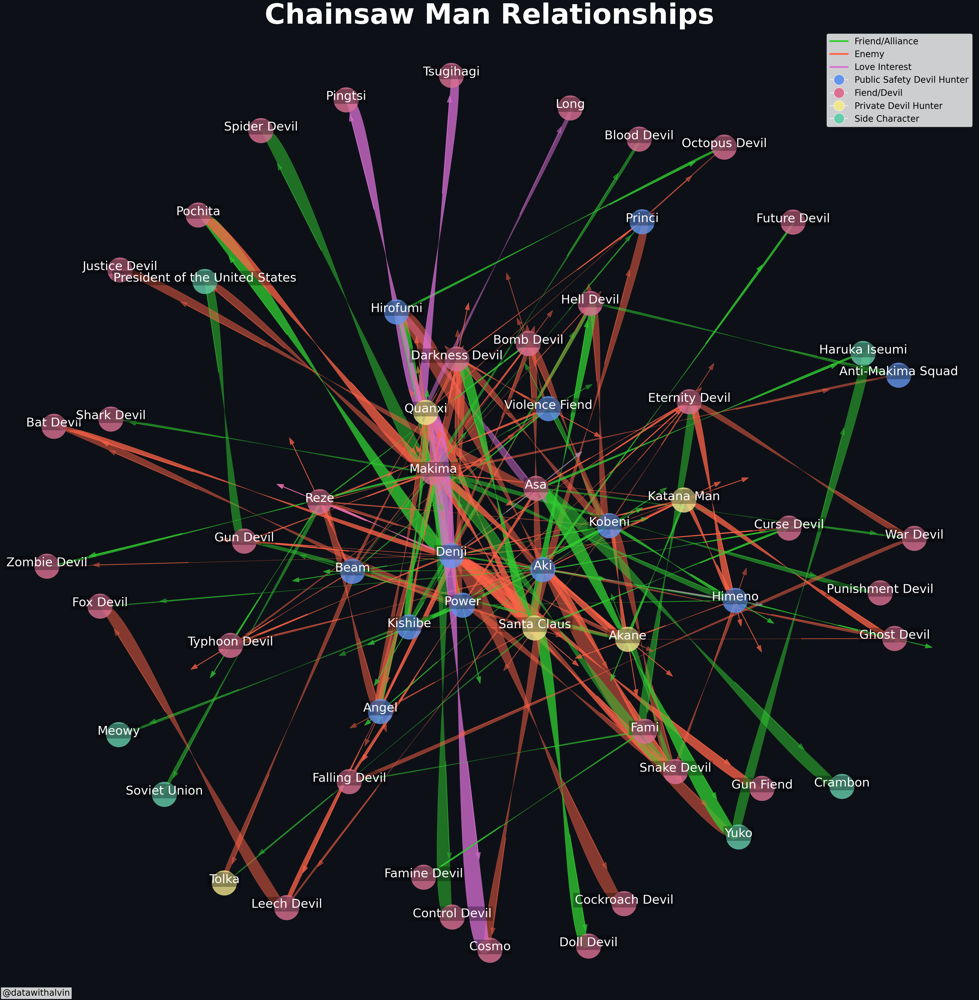

In [65]:
# Label Propagation method
communities = list(label_propagation_communities(MG))
partition_label_propagation = {node: i for i, com in enumerate(communities) for node in com}
# Uncomment the line below to use Label Propagation instead of Louvain method
partition = partition_label_propagation

def community_layout(g, partition):
    pos_communities = nx.spring_layout(g, seed=666, k=1.25)  # Position of communities

    # Find the center of each community
    community_centers = {}
    for node, community in partition.items():
        if community not in community_centers:
            community_centers[community] = []
        community_centers[community].append(pos_communities[node])

    for community, nodes_positions in community_centers.items():
        community_centers[community] = np.mean(nodes_positions, axis=0)

    # Position nodes within their communities
    pos_nodes = {}
    for node, community in partition.items():
        pos_nodes[node] = pos_communities[node] - community_centers[community]

    return pos_nodes


# Use community_layout function for positioning nodes
pos = community_layout(MG, partition)

# Set edge colors based on their relationship (pastel shades)
color_map = {
    'Friend/Alliance': 'limegreen',
    'Enemy': 'tomato',
    'Love Interest': 'orchid',
}

node_colors = {
    'Public Safety Devil Hunter': 'lightskyblue',
    'Devil/Fiend': 'lightcoral',
    "Private Devil Hunter": "mediumaquamarine",
    "Side Character": "wheat"
}

# Replace relationship names with colors in the edge_colors list
edge_colors = [color_map[MG[u][v][k]['relationship']] for u, v, k in MG.edges(keys=True)]

# Create a list of node colors based on occupation affiliation
node_colors = [occupation_colors.get(occupation_dict[node], 'gray') for node in MG.nodes()]

# Create the figure
fig, ax = plt.subplots(figsize=(50, 50))

# Set the plot title
plt.title("Chainsaw Man Relationships", fontsize=80, fontweight='bold', color='white')

# Set equal node sizes
node_size = 5000

# Draw the MultiGraph
node_collection = nx.draw_networkx_nodes(MG, pos, node_size=node_size, node_color=node_colors, alpha=0.8)
draw_curved_edges(MG, pos, edgelist=MG.edges(keys=True), width=1, edge_color=edge_colors, alpha=0.5)

# Draw node labels with some offset to avoid overlapping
for node, (x, y) in pos.items():
    plt.text(x, y, s=node, bbox=dict(facecolor='black', edgecolor='none', alpha=0.3), horizontalalignment='center', fontsize=35, color='white')

# Create custom legend elements for edge relationships
relationship_legend_elements = [Line2D([0], [0], color=color_map[rel], lw=5, label=rel) for rel in color_map.keys()]

# Create custom legend elements for occupation affiliations (with circle symbols)
occupation_legend_elements = [Line2D([0], [0], marker='o', color='w', label=occ,
                                    markerfacecolor=occupation_colors[occ], markersize=30) for occ in occupation_colors.keys()]

# Combine edge relationship and occupation affiliation legends
legend_elements = relationship_legend_elements + occupation_legend_elements
plt.legend(handles=legend_elements, loc='upper right', fontsize='x-large', prop={'size': 25}, ncol=1)

notes2 = ("@datawithalvin")
plt.text(0, 0, notes2, fontsize=25, ha='left', va='bottom', transform=plt.gca().transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='none'), wrap=True)

# Set the face color and remove the border
ax.set_facecolor('#0d1117')
ax.axis('off')
fig.set_facecolor('#0d1117')

# Display the plot
plt.show()
